In [1]:
import numpy as np
from PIL import Image

img = Image.open('/home/dex/Desktop/ml/super resolution/image-super-resolution/data/input/sample/baboon.png')
lr_img = np.array(img)

Using TensorFlow backend.
W1208 13:39:40.641180 139749703612224 deprecation_wrapper.py:119] From /home/dex/anaconda3/envs/keras_env/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W1208 13:39:40.654209 139749703612224 deprecation_wrapper.py:119] From /home/dex/anaconda3/envs/keras_env/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W1208 13:39:41.997695 139749703612224 deprecation_wrapper.py:119] From /home/dex/anaconda3/envs/keras_env/lib/python3.7/site-packages/keras/backend/tensorflow_backend.py:2018: The name tf.image.resize_nearest_neighbor is deprecated. Please use tf.compat.v1.image.resize_nearest_neighbor instead.

W1208 13:39:42.007612 139749703612224 deprecation_wrapper.py:119] From /home/dex/anaconda3/envs/keras_env/lib/python3.7/site-packages/keras/backend/tensorflow_b

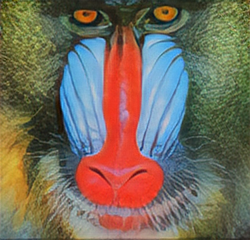

In [2]:
from ISR.models import RDN

rdn = RDN(arch_params={'C':6, 'D':20, 'G':64, 'G0':64, 'x':2})
rdn.model.load_weights('weights/sample_weights/rdn-C6-D20-G64-G064-x2/ArtefactCancelling/rdn-C6-D20-G64-G064-x2_ArtefactCancelling_epoch219.hdf5')

sr_img = rdn.predict(lr_img)
Image.fromarray(sr_img)

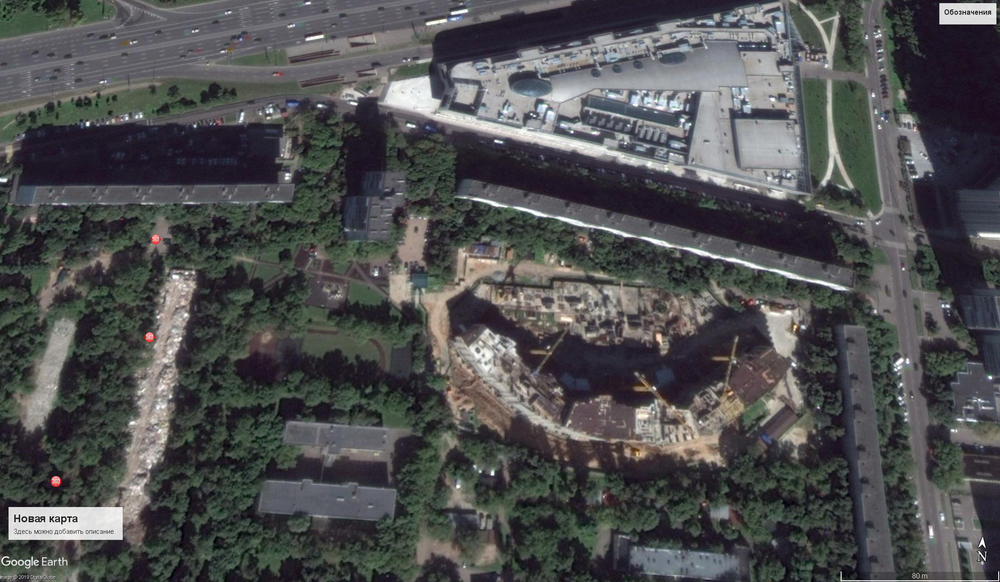

In [6]:
import numpy as np
from PIL import Image

img = Image.open('/home/dex/Desktop/ЖК Триумфальный_2016-08-28.jpg')
lr_img = np.array(img)
Image.fromarray(lr_img)

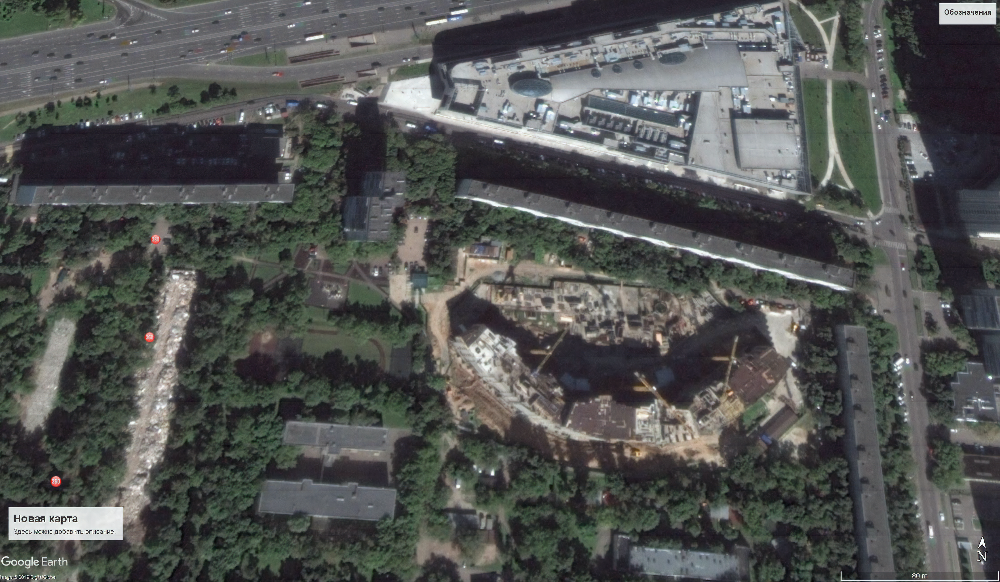

In [8]:
from ISR.models import RDN
#C6-D20-G64-G064-x2_ArtefactCancelling
rdn = RDN(arch_params={'C':6, 'D':20, 'G':64, 'G0':64, 'x':2})
rdn.model.load_weights('/home/dex/Desktop/ml/super resolution/image-super-resolution/weights/sample_weights/rdn-C6-D20-G64-G064-x2/ArtefactCancelling/rdn-C6-D20-G64-G064-x2_ArtefactCancelling_epoch219.hdf5')

sr_img = rdn.predict(lr_img, by_patch_of_size=100)
Image.fromarray(sr_img)

In [4]:
from ISR.models import RRDN
from ISR.models import Discriminator
from ISR.models import Cut_VGG19

lr_train_patch_size = 1
layers_to_extract = [5, 9]
scale = 2
hr_train_patch_size = lr_train_patch_size * scale

rrdn  = RRDN(arch_params={'C':4, 'D':3, 'G':64, 'G0':64, 'T':10, 'x':scale}, patch_size=lr_train_patch_size)
f_ext = Cut_VGG19(patch_size=hr_train_patch_size, layers_to_extract=layers_to_extract)
discr = Discriminator(patch_size=hr_train_patch_size, kernel_size=3)


from ISR.train import Trainer
loss_weights = {
  'generator': 0.0,
  'feature_extractor': 0.0833,
  'discriminator': 0.01
}
losses = {
  'generator': 'mae',
  'feature_extractor': 'mse',
  'discriminator': 'binary_crossentropy'
}

log_dirs = {'logs': './logs', 'weights': './weights'}

learning_rate = {'initial_value': 0.0004, 'decay_factor': 0.5, 'decay_frequency': 30}

flatness = {'min': 0.0, 'max': 0.15, 'increase': 0.01, 'increase_frequency': 5}

trainer = Trainer(
    generator=rrdn,
    discriminator=discr,
    feature_extractor=f_ext,
    lr_train_dir='low_res/training/images',
    hr_train_dir='high_res/training/images',
    lr_valid_dir='low_res/validation/images',
    hr_valid_dir='high_res/validation/images',
    loss_weights=loss_weights,
    learning_rate=learning_rate,
    flatness=flatness,
    dataname='image_dataset',
    log_dirs=log_dirs,
    weights_generator=None,
    weights_discriminator=None,
    n_validation=1,
)

ValueError: Negative dimension size caused by subtracting 2 from 1 for 'vgg19_3/block2_pool/MaxPool' (op: 'MaxPool') with input shapes: [?,1,1,128].

In [ ]:
trainer.train(
    epochs=80,
    steps_per_epoch=500,
    batch_size=16,
    monitored_metrics={'val_PSNR_Y': 'max'}
)